# Auxiliar 2 

## 1. Repaso Cubo LBV

## 2. Maneras de Separar Ruido de Senal

## 3.  Curva de rotacion

### Como leer un cubo de datos

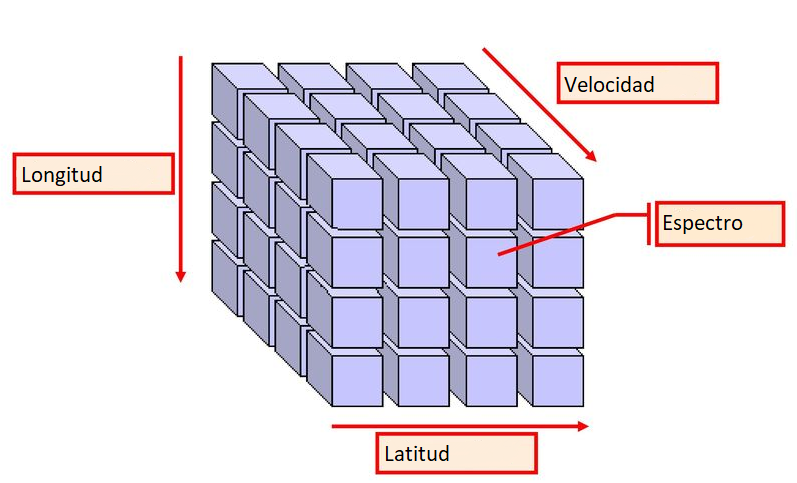


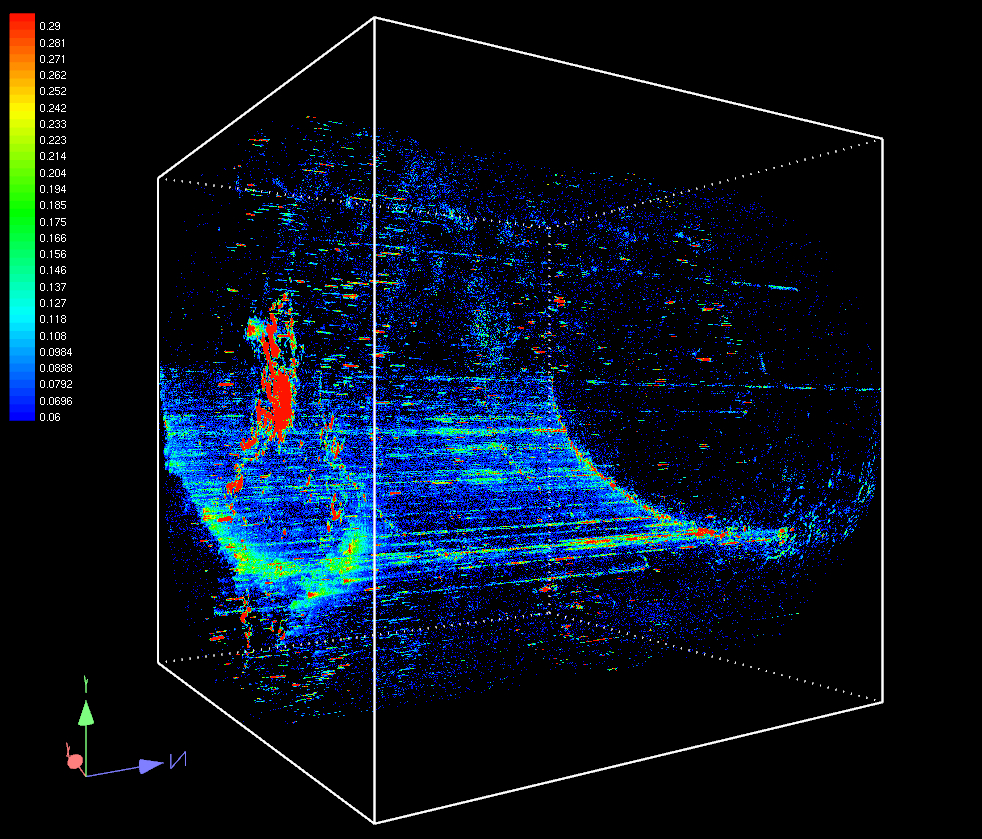

In [1]:
from IPython import display
display.Image("https://wallaby-survey.org/wp-content/uploads/2018/04/HIPASS-3D-Cube.jpg")

In [89]:
# Solo para omitir warnings, en general NO deberían usarlo
import warnings
warnings.filterwarnings("ignore")

#import pyfits #modulo para leer archivos fits
from astropy.io import fits
import matplotlib.pyplot as plt #modulo para graficar
import numpy as np #este modulo es para trabajar con matrices como en matlab
import scipy as sp
from scipy import ndimage

import pandas as pd 

In [3]:
cubo = fits.open("southgal_fixbadc.fits") #abrir objeto cubo de datos
data = cubo[0].data #extraer matriz de datos
header= cubo[0].header #extraer el header del archivo fits

In [5]:
header, data.shape #()

(SIMPLE  =                    T  / Standard FITS format                          
 BITPIX  =                  -32 / Bits per pixel                                 
 NAXIS   =                    3  / Number of axes                                
 NAXIS1  =                  306  / Number pixels on axis 1                       
 NAXIS2  =                  385  / Number pixels on axis 2                       
 NAXIS3  =                   33  / Number pixels on axis 3                       
 CTYPE1  = 'VELO-LSR'            / axis 1 coord type                             
 CRVAL1  =        -2.307985E+02 / coord value at CRPIX1                          
 CDELT1  =         1.300400E+00 / pixel spacing for axis 1                       
 CRPIX1  =             1.000000  / ref pixel for axis 1                          
 CTYPE2  = 'GLON-FLT'            / axis 2 coord type                             
 CRVAL2  =         3.000000E+02 / coord value at CRPIX2                          
 CDELT2  =      

Esta es una forma "automatizada" de obtener la velocidad(v) longitud(l) y latitud(b)

Esta funcion les entrega un arreglo con los valores reales del eje correspondiente


1 es velocidad, 2 es longitud galactica, 3 es latitud galactica

In [7]:
# funcion para obtener los valores de los ejes l, b, v
def values(h,j):
    N=h['NAXIS'+str(j)];
    val=np.zeros(N)
    for i in range(0,N):
        val[i] = (i+1-float(h['CRPIX'+str(j)]))*float(h['CDELT'+str(j)]) + float(h['CRVAL'+str(j)])
    return val

In [8]:
#Estos seran los tres arreglos con los valores reales de los tres ejes del cubo
velocidad=values(header,1)
longitud=values(header,2)
latitud=values(header,3)



In [11]:
velocidad, longitud, latitud # (-230, 165) km/s , (300, 348)º, (-2, 2)º

(array([-230.7985, -229.4981, -228.1977, -226.8973, -225.5969, -224.2965,
        -222.9961, -221.6957, -220.3953, -219.0949, -217.7945, -216.4941,
        -215.1937, -213.8933, -212.5929, -211.2925, -209.9921, -208.6917,
        -207.3913, -206.0909, -204.7905, -203.4901, -202.1897, -200.8893,
        -199.5889, -198.2885, -196.9881, -195.6877, -194.3873, -193.0869,
        -191.7865, -190.4861, -189.1857, -187.8853, -186.5849, -185.2845,
        -183.9841, -182.6837, -181.3833, -180.0829, -178.7825, -177.4821,
        -176.1817, -174.8813, -173.5809, -172.2805, -170.9801, -169.6797,
        -168.3793, -167.0789, -165.7785, -164.4781, -163.1777, -161.8773,
        -160.5769, -159.2765, -157.9761, -156.6757, -155.3753, -154.0749,
        -152.7745, -151.4741, -150.1737, -148.8733, -147.5729, -146.2725,
        -144.9721, -143.6717, -142.3713, -141.0709, -139.7705, -138.4701,
        -137.1697, -135.8693, -134.5689, -133.2685, -131.9681, -130.6677,
        -129.3673, -128.0669, -126.766

## Ahora pueden trabajar con el cubo como si fuera una matriz

### Ejemplo 1a, graficar el espectro localizado en l=325.00 y b=-0.25

14 200


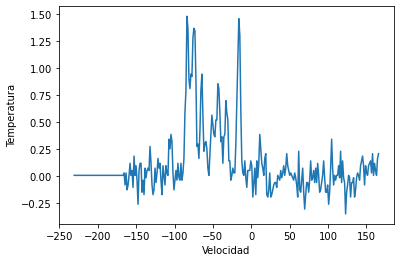

In [21]:
i_l=-1
i_b=-1
i_k=-1
#con este par de ciclos buscan en que indice esta la longitud y la latitud esperada
for i,lat in enumerate(latitud):
    if lat == -0.25:
        i_b = i
for j,lon in enumerate(longitud):
    if lon <= 325.0:
        i_l = j

print(i_b, i_l)
# ahora grafican el espectro
# cuidado
# para llamar en data el orden es indice lat, indice longitud, indice velocidad
# al reves del orden del header

plt.plot(velocidad, data[i_b][i_l][:])
plt.xlabel('Velocidad')
plt.ylabel('Temperatura')

plt.show()

### Ejemplo 1b, graficar el espectro localizado en l=325.00 y b=-0.25

Aca lo hacemos más directo, evitando hacer iteraciones con np.where

200 14


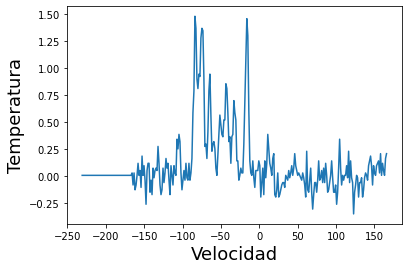

In [23]:
lon_i = np.where(longitud== 325.0)[0][0]
lat_i = np.where(latitud== -0.25)[0][0]

print(lon_i,lat_i)
####
plt.plot(velocidad, data[lat_i][lon_i][:])

plt.xlabel('Velocidad', fontsize=18)
plt.ylabel('Temperatura', fontsize=18)

plt.show()

### Ejemplo 2a, hacer un mapa de contornos de todo el cubo.


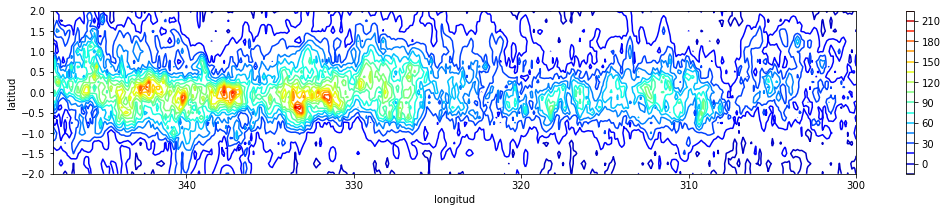

In [9]:
#Ejemplo 2, hacer un mapa de contornos de todo el cubo.
#Para esto integran en velocidad, colapsan el eje de velocidad para que les quede un fits en 2 dimensiones, latitud y longitud

data_2 = np.zeros((len(latitud),len(longitud))) #con esto crean un imagen con ceros de las dimensiones de latitud y longitud
for i in range(len(latitud)):
    for j in range(len(longitud)):
        data_2[i][j] = sum(data[i][j][:])

        
#plotean los contornos

fig2=plt.figure(figsize=(18,3))
plt.xlabel('longitud')
plt.ylabel('latitud')
plt.contour(longitud,latitud,data_2, levels=20, cmap='jet')
plt.xlim(348, 300)
plt.colorbar()
plt.show()


### Ejemplo 2b, hacer un mapa de contornos de todo el cubo.

Contornos tomando el promedio de las temperaturas a lo largo de la coordenada de velocidades


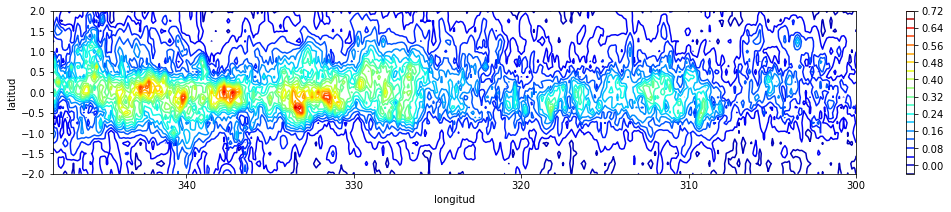

Contornos tomando el valor mediano de las temperaturas a lo largo de la coordenada de velocidades


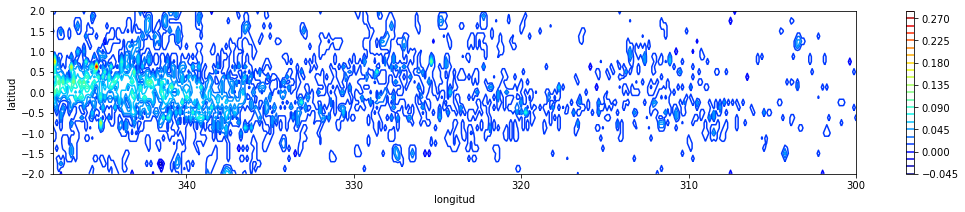

Contornos tomando el valor máximo de las temperaturas a lo largo de la coordenada de velocidades


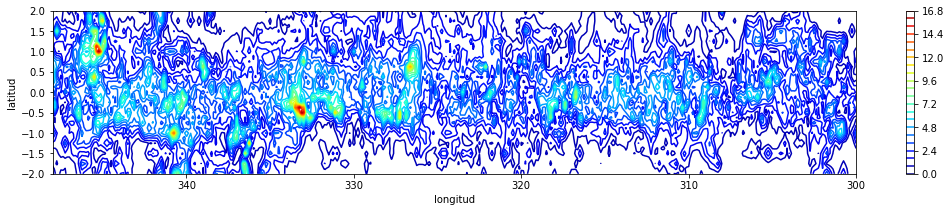

Contornos tomando el valor en la posición velocidades[index]
100


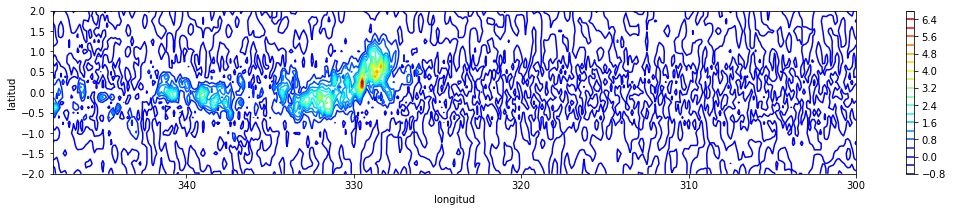

In [34]:
print('Contornos tomando el promedio de las temperaturas a lo largo de la coordenada de velocidades')
data_2 = np.nanmean(data, axis=2) #con esto promediamos los valores en la coordenada de las velocidades
  
#plotean los contornos

fig2=plt.figure(figsize=(18,3))
plt.xlabel('longitud')
plt.ylabel('latitud')
plt.contour(longitud,latitud,data_2, levels=20, cmap='jet')
plt.xlim(348, 300)
plt.colorbar()
plt.show()

##############################################################################################
print('Contornos tomando el valor mediano de las temperaturas a lo largo de la coordenada de velocidades')
data_2b = np.nanmedian(data, axis=2) #con esto promediamos los valores en la coordenada de las velocidades

#plotean los contornos

fig2=plt.figure(figsize=(18,3))
plt.xlabel('longitud')
plt.ylabel('latitud')
plt.contour(longitud,latitud,data_2b, levels=20, cmap='jet')
plt.xlim(348, 300)
plt.colorbar()
plt.show()

##############################################################################################
print('Contornos tomando el valor máximo de las temperaturas a lo largo de la coordenada de velocidades')
data_2c = np.nanmax(data, axis=2) #con esto promediamos los valores en la coordenada de las velocidades
 
#plotean los contornos

fig2=plt.figure(figsize=(18,3))
plt.xlabel('longitud')
plt.ylabel('latitud')
plt.contour(longitud,latitud,data_2c, levels=20, cmap='jet')
plt.xlim(348, 300)
plt.colorbar()
plt.show()

##############################################################################################
print('Contornos tomando el valor en la posición velocidades[index]')
index = 100
print(index)

#plotean los contornos

fig2=plt.figure(figsize=(18,3))
plt.xlabel('longitud')
plt.ylabel('latitud')
plt.contour(longitud,latitud,data[:,:,index], levels=20, cmap='jet')
plt.xlim(348, 300)
plt.colorbar()
plt.show()

### Ejemplo 3, hacer un mapa del cubo.

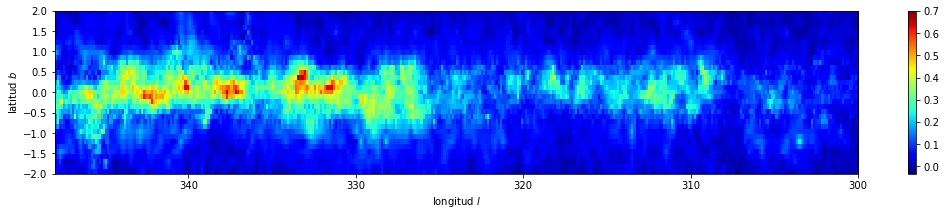

In [35]:
# Lo mismo que ejemplo 2 pero con imshow, no contours (Para caso del promedio)

fig3=plt.figure(figsize=(18,3))
plt.imshow(data_2, interpolation='nearest', aspect='auto', cmap='jet',
           extent=[min(longitud), max(longitud), min(latitud), max(latitud)])
plt.xlabel(r'longitud $l$')
plt.ylabel(r'latitud $b$') 
plt.colorbar()
plt.gca().invert_xaxis() # por defecto el eje esta al reves
plt.show()

### Ejemplo 4a: Se hace un mapa de longitud vs. velocidad

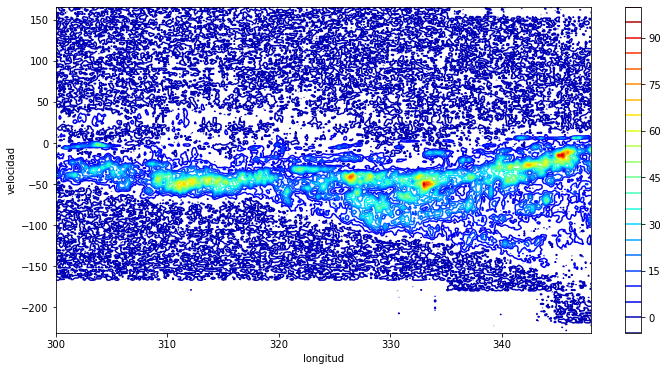

In [11]:
data_3 = np.zeros((len(velocidad),len(longitud))) 
for i in range(len(velocidad)):
    for j in range(len(longitud)):
        # Es necesario crear un arreglo auxiliar con los valores para cada b, dado un l,v
        aux=np.zeros(33)
        for h in range(33):
            aux[h]=data[h][j][i]
        data_3[i][j] = sum(aux)

#plotean los contornos
fig2=plt.figure(figsize=(12,6))
plt.contour(longitud,velocidad,data_3, levels=20, cmap='jet')
plt.xlabel('longitud')
plt.ylabel('velocidad')
#plt.xlim(350, 300)
plt.colorbar()
plt.show()

### Ejemplo 4b: Se hace un mapa de longitud vs. velocidad (sin iteraciones)

(385, 306) (385, 306) (306, 385)


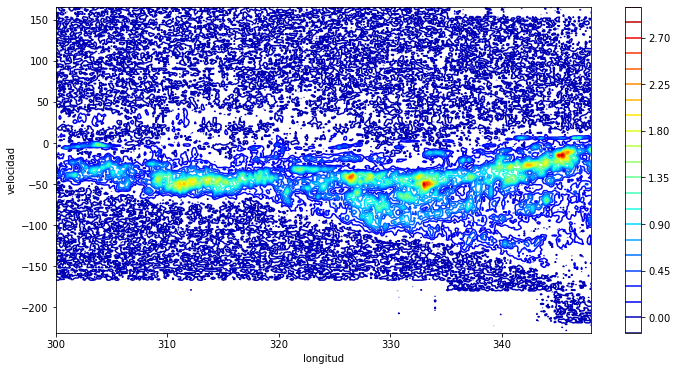

latitude = -2.0


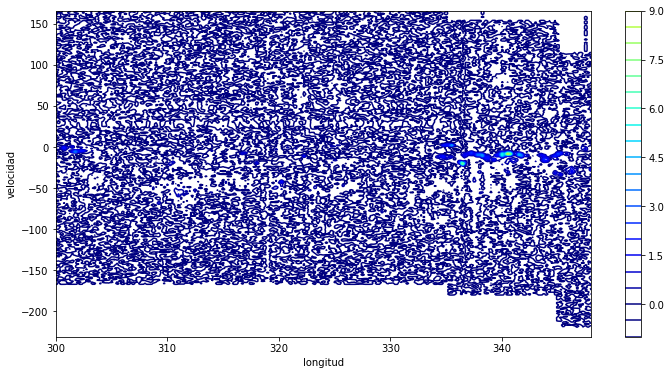

latitude = -1.875


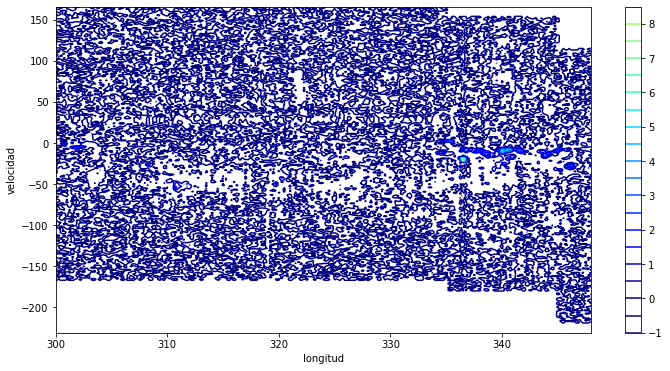

latitude = -1.75


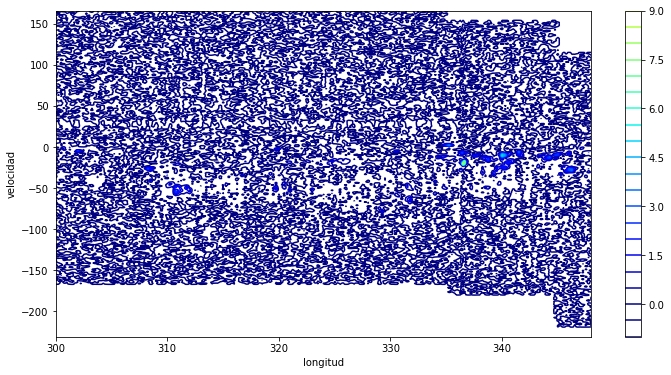

latitude = -1.625


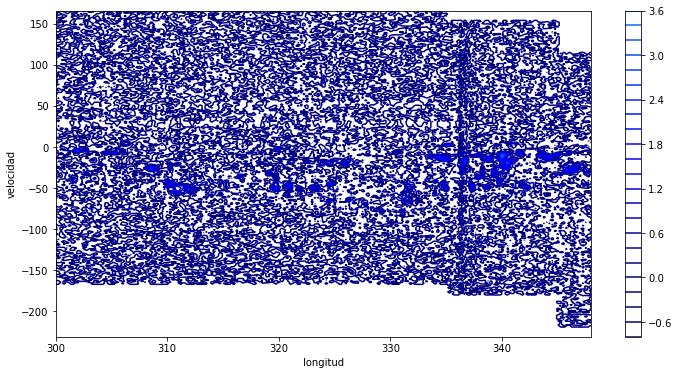

latitude = -1.5


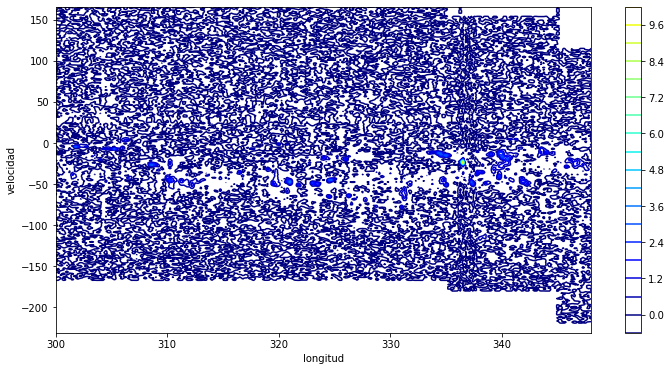

latitude = -1.375


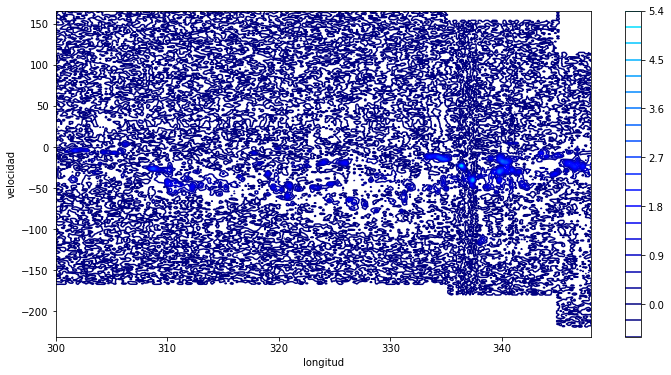

latitude = -1.25


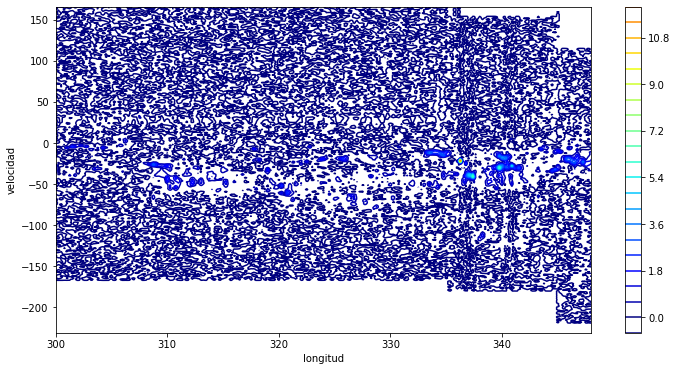

latitude = -1.125


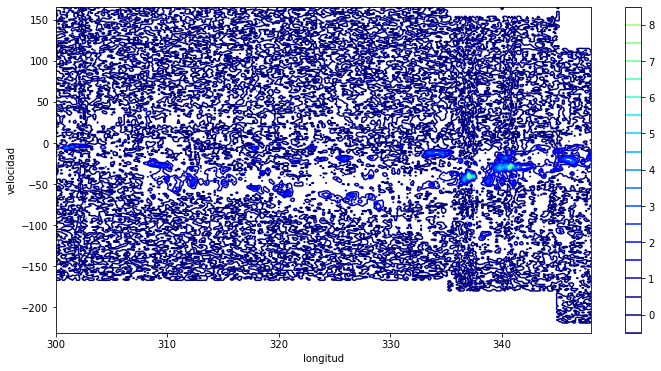

latitude = -1.0


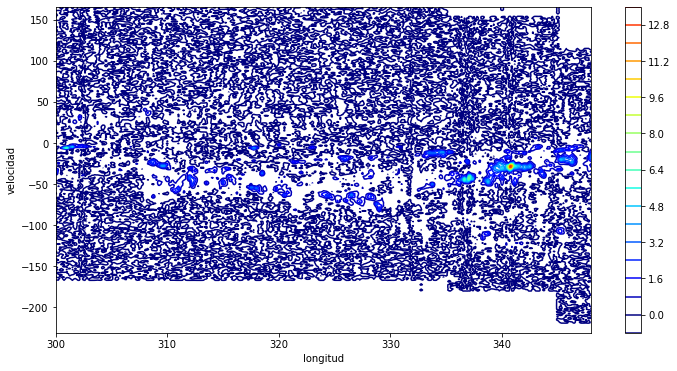

latitude = -0.875


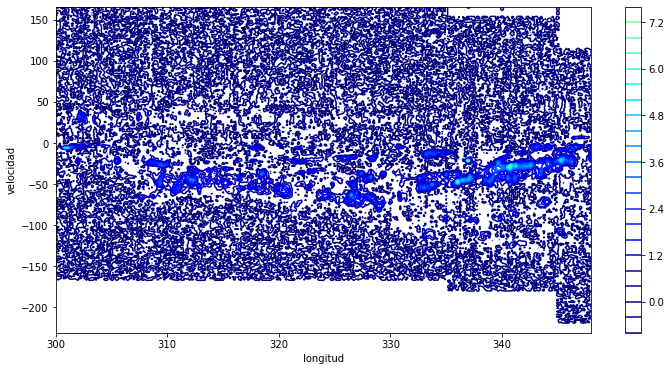

latitude = -0.75


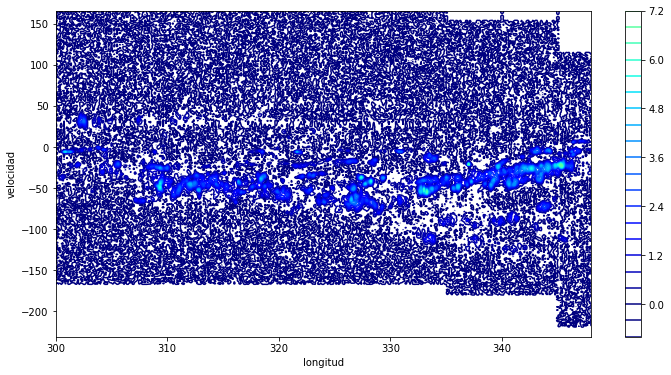

latitude = -0.625


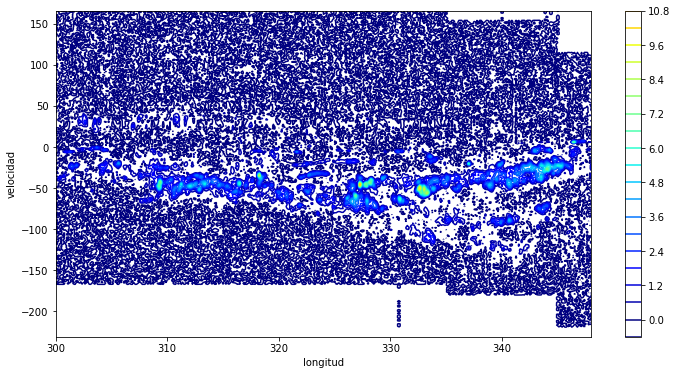

latitude = -0.5


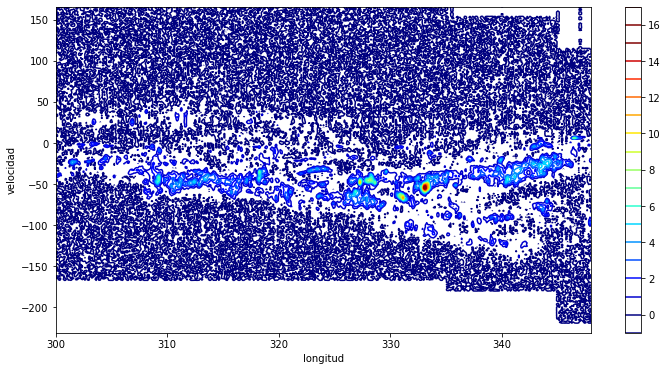

latitude = -0.375


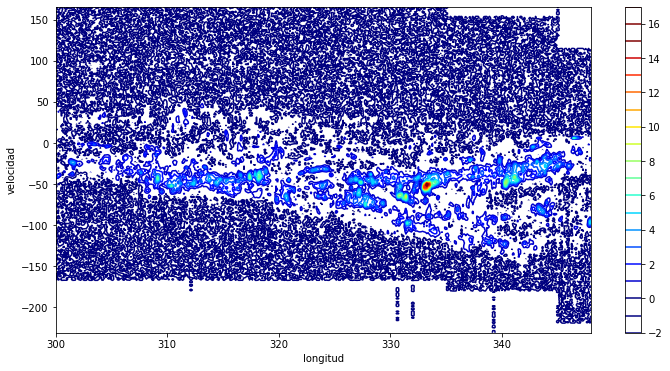

latitude = -0.25


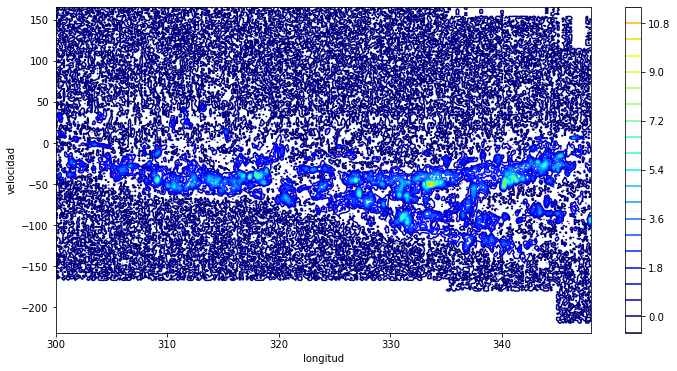

latitude = -0.125


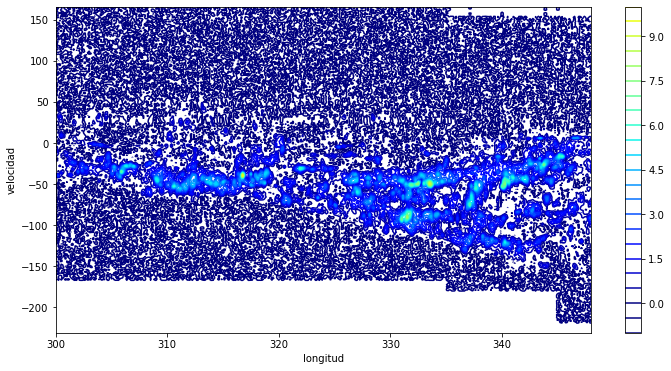

latitude = 0.0


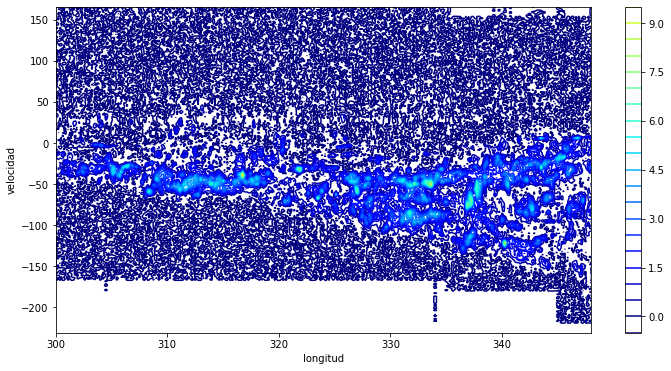

latitude = 0.125


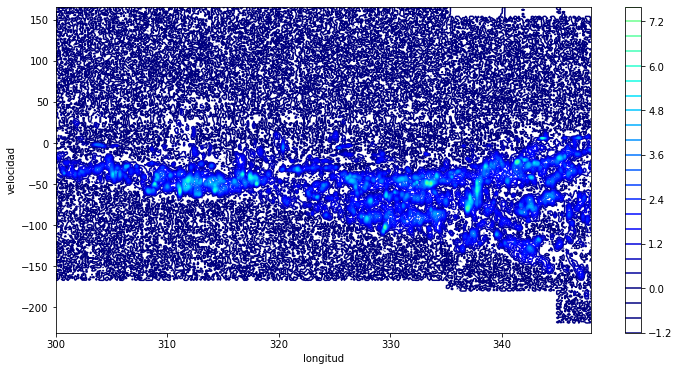

latitude = 0.25


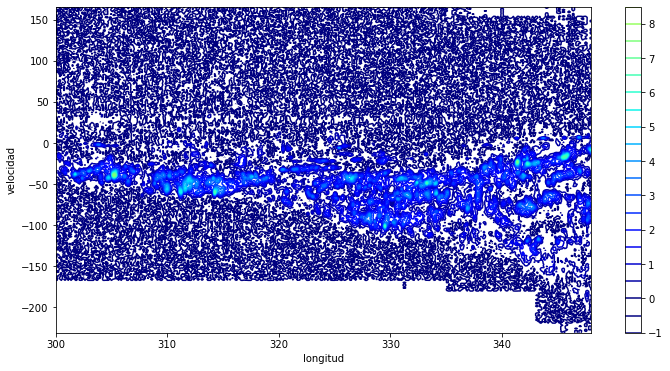

latitude = 0.375


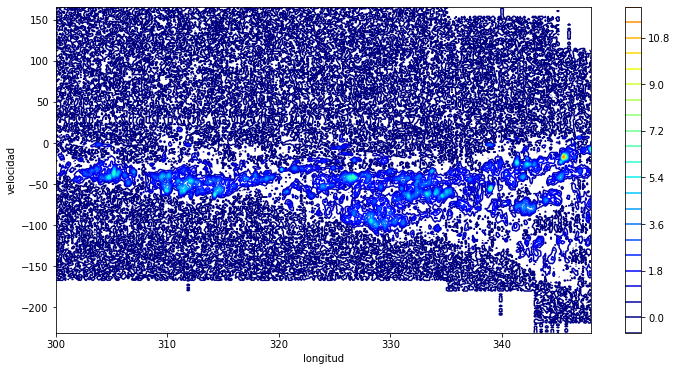

latitude = 0.5


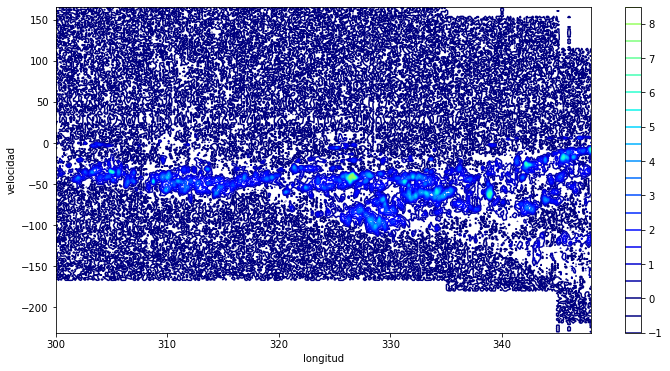

latitude = 0.625


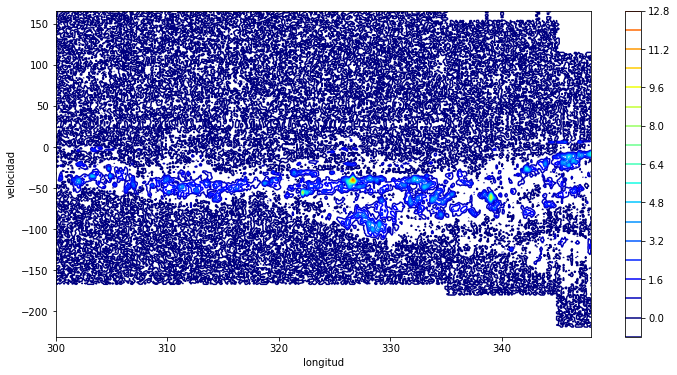

latitude = 0.75


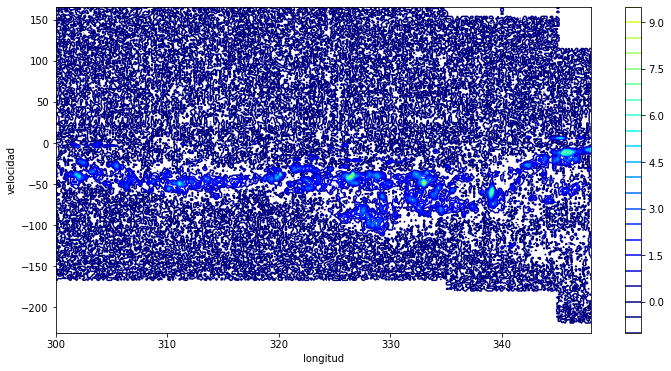

latitude = 0.875


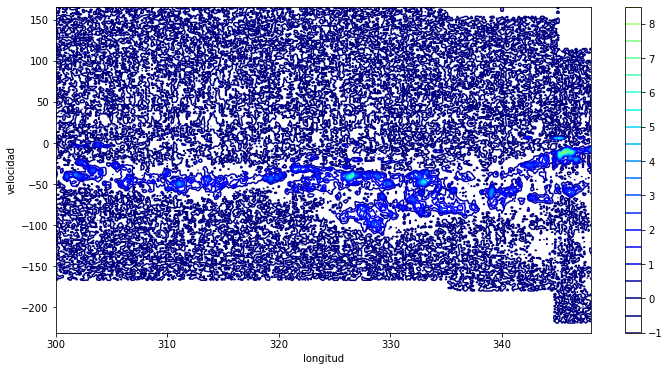

latitude = 1.0


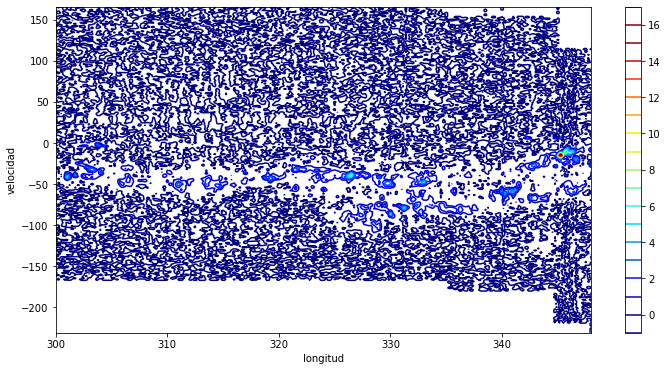

latitude = 1.125


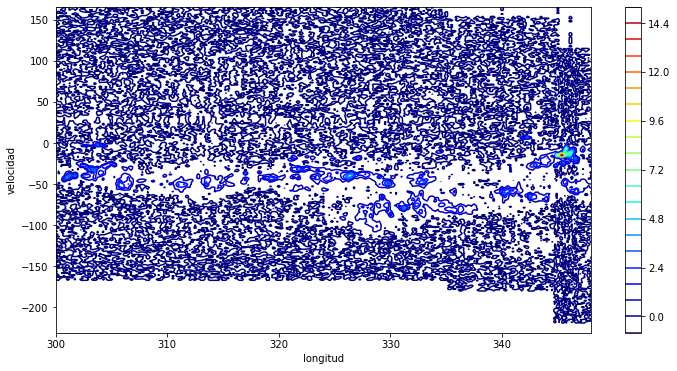

latitude = 1.25


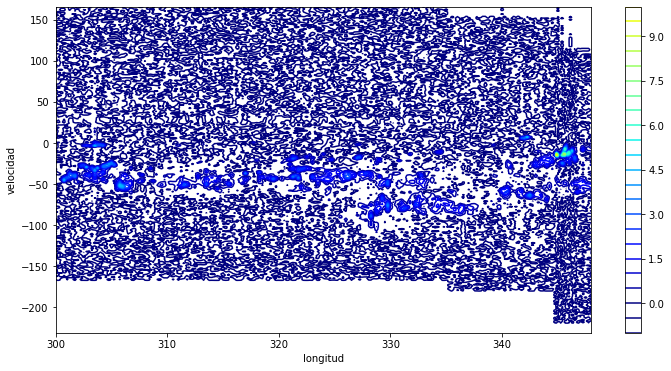

latitude = 1.375


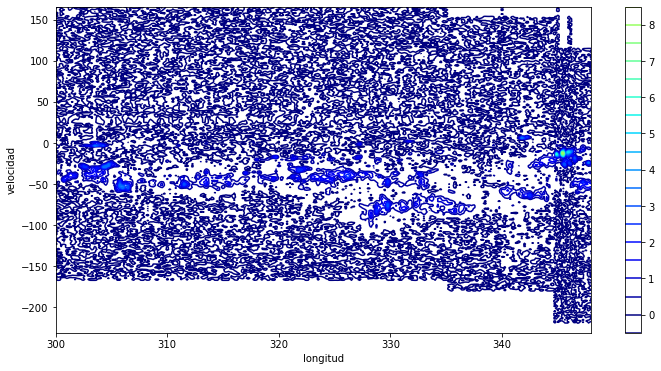

latitude = 1.5


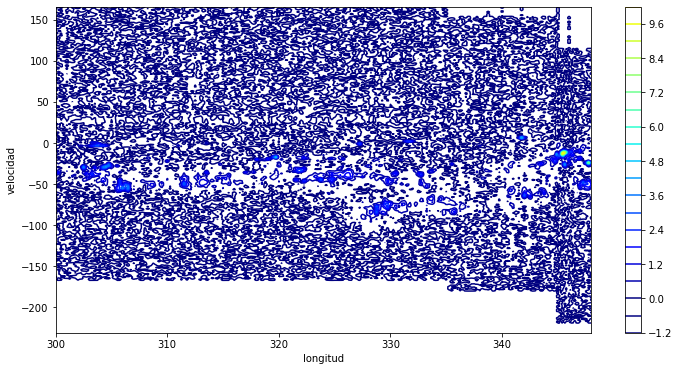

latitude = 1.625


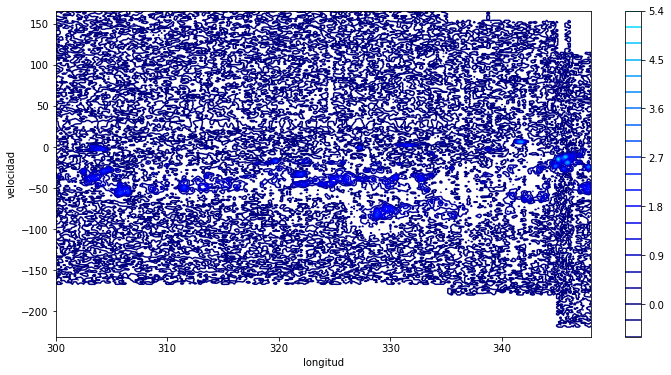

latitude = 1.75


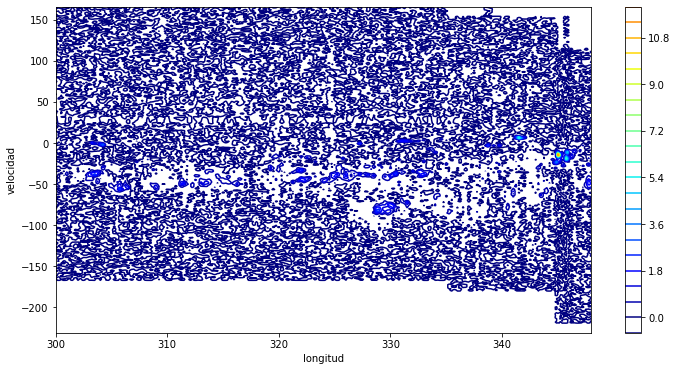

latitude = 1.875


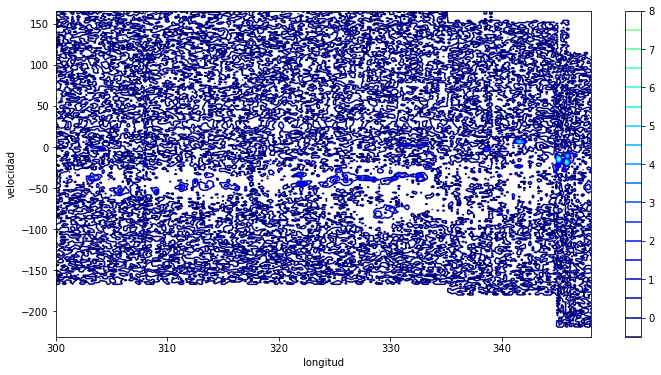

latitude = 2.0


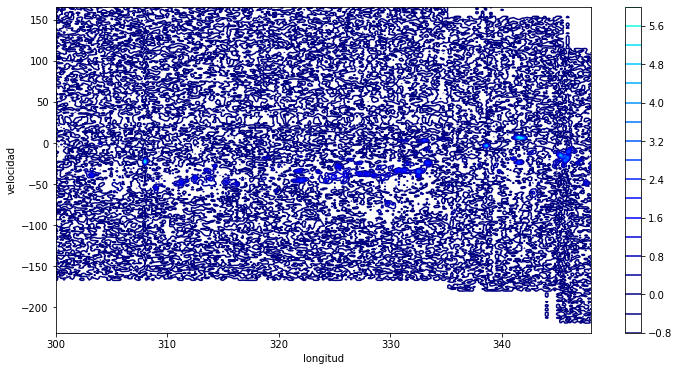

In [67]:

data_3b = np.nanmean(data, axis=0) #con esto promediamos los valores en la coordenada de las velocidades
data_3bb = np.flipud(data_3b)
data_3bbb = ndimage.rotate(data_3bb, -90)

print(data_3b.shape, data_3bb.shape, data_3bbb.shape)

#plotean los contornos
fig2=plt.figure(figsize=(12,6))
plt.contour(longitud,velocidad,data_3bbb, levels=20, cmap='jet')
plt.xlabel('longitud')
plt.ylabel('velocidad')
#plt.xlim(350, 300)
plt.colorbar()
plt.show()

#######################################################################
for i in range(len(data[:,0,0])):
    data_3b = data[i,:,:] #con esto promediamos los valores en la coordenada de las velocidades
    data_3bb = np.flipud(data_3b)
    data_3bbb = ndimage.rotate(data_3bb, -90)
    print('latitude = '+str(latitud[i]))
    #plotean los contornos
    fig2=plt.figure(figsize=(12,6))
    plt.contour(longitud,velocidad,data_3bbb, levels=20, cmap='jet', vmin=0, vmax=15)
    plt.xlabel('longitud')
    plt.ylabel('velocidad')
    #plt.xlim(350, 300)
    plt.colorbar()
    plt.show()

# 2. Maneras de Separar Ruido de Senal

## 2a. Se hace al ojo

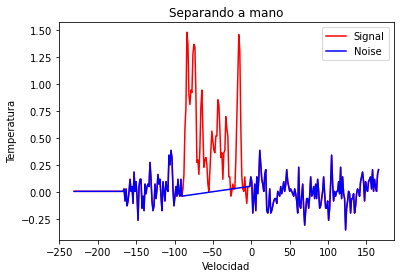

In [86]:
ruido = np.where((velocidad <= -90) | (velocidad >= -4)) #esta es la peor forma porque tienen que cortar a mano
T = data[i_b][i_l][:]
plt.plot(velocidad, T, color='r', label='Signal') 
plt.plot(velocidad[ruido], T[ruido], color='b', label='Noise')
plt.legend()
plt.xlabel('Velocidad')
plt.ylabel('Temperatura')
plt.title('Separando a mano')
plt.show()

Se hpuede mejorar dando al ojo un valor para el límite del ruido en función de la temperatura

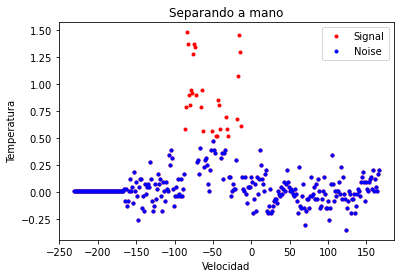

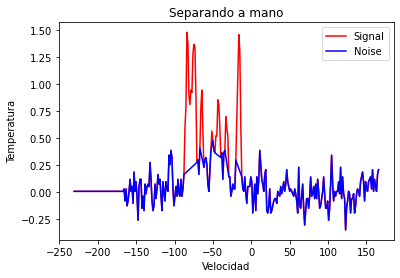

In [70]:

T = data[i_b][i_l][:] #i_b = 14 i_l =200
ruido = np.where(T<0.5 ) #unidades de K  # otra forma es T>0.5  
plt.plot(velocidad, T, '.',color='r', label='Signal') 
plt.plot(velocidad[ruido], T[ruido],'.', color='b', label='Noise')
plt.legend()
plt.xlabel('Velocidad')
plt.ylabel('Temperatura')
plt.title('Separando a mano')
plt.show()

T = data[i_b][i_l][:]
ruido = np.where(T<0.5 ) #otra forma es T>0.5  
plt.plot(velocidad, T,color='r', label='Signal') 
plt.plot(velocidad[ruido], T[ruido], color='b', label='Noise')
plt.legend()
plt.xlabel('Velocidad')
plt.ylabel('Temperatura')
plt.title('Separando a mano')
plt.show()

Se encuentra V_terminal cuando no se tiene mascara y sin iterar

In [81]:
index_tan_2 = np.where(T >= 0.5)[0] # definimos a mano el límite para considerar no-ruido
print(index_tan_2)

v_tan_2 = velocidad[index_tan_2[0]]

print( 'v_terminal sin mascara =', v_tan_2)

[111 112 113 114 115 116 117 118 119 120 121 122 127 128 129 138 142 143
 144 145 146 152 153 154 163 164 165 166 167]
v_terminal sin mascara = -86.45409999999998


## 2b. Se hace usando Sigma clipping

In [82]:
from astropy.stats import sigma_clip

#r = sigma_clip(T, sigma=3)
r = sigma_clip(T, sigma_lower=3, sigma_upper=3)
rms = np.sqrt(np.mean(r**2))
rmask = r.mask
v_tan = velocidad[rmask][0]
print ('v_tan con mascara =', v_tan)

v_tan con mascara = -86.45409999999998


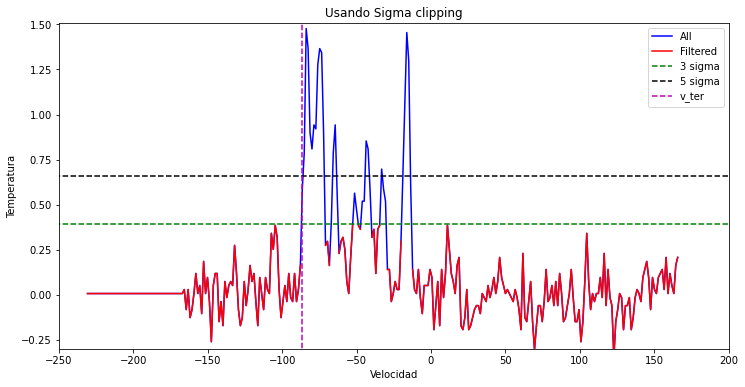

In [87]:
fig=plt.figure(figsize=(12,6))
plt.plot(velocidad, T, color='b', label='All')
plt.plot(velocidad, r, color='r', label='Filtered')
plt.plot([-300,300],[3*rms,3*rms], 'g--', label='3 sigma')
plt.plot([-300,300],[5*rms,5*rms], 'k--', label='5 sigma')
plt.plot([v_tan,v_tan],[-10,10], 'm--', label='v_ter')
plt.xlim(-250,200)
plt.ylim(-0.3,1.51)
plt.xlabel('Velocidad')
plt.ylabel('Temperatura')
plt.legend()
plt.title('Usando Sigma clipping')
plt.show()



Otra forma de encontrar V_terminal cuando no se tiene mascara, pero no la recomiendo en un principio porque si se puede evitar iterar, hay que evitarlo

In [85]:
v_tan_2 = np.nan

for i in range(len(T)):
    temp = T[i]
    if temp >= 5*rms:
        v_tan_2 = velocidad[i]
        break
print( 'v_terminal sin mascara =', v_tan_2)

v_terminal sin mascara = -85.15369999999999


Como recomendación porían hacer una tabla para todoas las combinaciones de los valores de l, b, con el resultado de v_tan en cada caso

In [96]:
columns = ['longitud l', 'latitud b', 'v_tan']
tabla = pd.DataFrame(columns=columns)

for i_b in range(len(latitud)):
    for i_l in range(len(longitud)):
        T = data[i_b][i_l][:]
        r = sigma_clip(T, sigma_lower=3, sigma_upper=3)
        rms = np.sqrt(np.mean(r**2))
        rmask = r.mask
        if len(velocidad[rmask])==0:
            v_tan = np.nan
        else:
            v_tan = velocidad[rmask][0]
        
        tabla = tabla.append({'longitud l':longitud[i_l], 'latitud b':latitud[i_b], 'v_tan':v_tan}, ignore_index=True) 

In [115]:
tabla

,longitud l,latitud b,v_tan
0,300.000,-2.0,-165.7785
1,300.125,-2.0,-61.7465
2,300.250,-2.0,-38.3393
3,300.375,-2.0,-160.5769
4,300.500,-2.0,-1.9281
...,...,...,...
12700,347.500,2.0,-51.3433
12701,347.625,2.0,-55.2445
12702,347.750,2.0,-52.6437
12703,347.875,2.0,-60.4461


Buscamos ahora máximo v_tan para cada latitud b, ejemplo para latitud -2.0

# 3.  Curva de rotacion

#### Partimos de la expresion para la Velocidad de local standard of rest

\begin{align}
V_{LSR} = R_{0} sin(l)[\omega(R) - \omega(R_{0}) ] 
\end{align}

#### Donde R0 es la distancia radial del Sol al centro de la galaxia, l la longitud y ω(R) es la velocidad angular con respecto al centro de la galaxia
#### Donde V(R_0) es la velocidad del sol respecto al centro galáctico, el valor de esta constante, corresponde a 220[km/s]. Ademas se puede calcular omega(R_0) como:

\begin{align}
\omega_0 = V(R_0)R_0
\end{align}

#### Con R_0=8.5kpc

#### Sin embargo, lo que se busca para realizar el calculo necesario son los máximos V_LSR, para esto senecesitan las velocidades tangenciales que ocurren cuando R = R0sin(l), por lo tanto se ocupara

\begin{align}
V^{max}_{LSR} =R0sin(l)[ω(R0sin(l)) − ω(R0)]
\end{align}


#### Valor que se calcula para cada punto del espectro, eligiendo para una longitud fija, la latitud que entregue el valor mas negativo entre todas las longitudes, así se puede calcular la velocidad de rotación como:

\begin{align}
\omega(R=R_0 sin(l)) = \frac{V_{LSR}^{MAX}}{R_0 sin(l)} + \omega(R_0) 
\end{align}



#### El signo - de la Vlsr se anula con el signo - de sin(l) en esta ecuación, en el cuarto cuadrante de longitud donde estamos trabajando (360 > l > 270)


#### Luego se obtiene la curva de velocidad de rotación como:


\begin{align}
V (R=R_0 sin(l)) =   \frac{V_{LSR}^{MAX} |sin(l)|}{sin(l)} + V(R_0) |sin(l)|
\end{align}

#### O tambien como:
\begin{align}
V (R=R_0 sin(l)) =  \omega (R=R_0 sin(l)) \cdot R_0 · |sin(l)| 
\end{align}

#### V(R) debe ser positivo por eso el valor absoluto en el seno


In [109]:
for lat in latitud:
    table_b_fix = tabla.loc[tabla['latitud b'] == lat]
    min_vel= table_b_fix['v_tan'].min()
    print(lat, min_vel)

-2.0 -189.1857
-1.875 -206.09089999999998
-1.75 -209.9921
-1.625 -193.08689999999999
-1.5 -199.5889
-1.375 -181.3833
-1.25 -207.3913
-1.125 -178.7825
-1.0 -185.28449999999998
-0.875 -204.79049999999998
-0.75 -204.79049999999998
-0.625 -194.38729999999998
-0.5 -209.9921
-0.375 -187.88529999999997
-0.25 -204.79049999999998
-0.125 -161.8773
0.0 -208.6917
0.125 -186.5849
0.25 -190.4861
0.375 -178.7825
0.5 -204.79049999999998
0.625 -170.9801
0.75 -217.7945
0.875 -204.79049999999998
1.0 -206.09089999999998
1.125 -204.79049999999998
1.25 -194.38729999999998
1.375 -193.08689999999999
1.5 -216.4941
1.625 -215.19369999999998
1.75 -215.19369999999998
1.875 -193.08689999999999
2.0 -215.19369999999998


In [118]:
for lon in longitud:
    table_b_fix = tabla.loc[tabla['longitud l'] == lon]
    min_vel= table_b_fix['v_tan'].min()
    print(lon, min_vel)
    
# Cual es la latitud correspondiente?

300.0 -165.7785
300.125 -159.2765
300.25 -163.1777
300.375 -160.5769
300.5 -131.9681
300.625 -156.6757
300.75 -154.07489999999999
300.875 -152.7745
301.0 -150.1737
301.125 -164.47809999999998
301.25 -165.7785
301.375 -152.7745
301.5 -151.4741
301.625 -144.97209999999998
301.75 -150.1737
301.875 -163.1777
302.0 -161.8773
302.125 -156.6757
302.25 -164.47809999999998
302.375 -131.9681
302.5 -152.7745
302.625 -152.7745
302.75 -159.2765
302.875 -152.7745
303.0 -152.7745
303.125 -152.7745
303.25 -148.87329999999997
303.375 -157.97609999999997
303.5 -157.97609999999997
303.625 -137.16969999999998
303.75 -159.2765
303.875 -152.7745
304.0 -148.87329999999997
304.125 -152.7745
304.25 -161.8773
304.375 -118.96409999999999
304.5 -164.47809999999998
304.625 -144.97209999999998
304.75 -156.6757
304.875 -151.4741
305.0 -154.07489999999999
305.125 -161.8773
305.25 -155.37529999999998
305.375 -152.7745
305.5 -103.35929999999999
305.625 -156.6757
305.75 -161.8773
305.875 -164.47809999999998
306.0 -163.1

In [119]:
# Se crea una funcion que para una longitud(l) fija, se recorre latitud(b) y se calcula el rms de las
# velocidades
# Esta misma funcion recorre el cubo de las velocidades asociadas a l y b, hasta que se llega a una
# velocidad que es 5 veces mayor que el rms, esta ultima se guarda un arreglo

def fmin(l,latitud,vs):
    #recorre latitud
    for q in range(33):
        T1=data[q][l][:]
        rms=np.sqrt(np.mean(T1**2))   #calcula rms
        #recorre velocidad
        for w in range(306):
            if data[q][l][w]>=5*rms:  #buscamos que no sea ruido
                vs[q]=velocidad[w]    #guardamos la primera v donde T mayor a 5rms
                break

vmin=np.zeros(385)
bvmin=np.zeros(385)
R=np.zeros(385)
R0=8.5 #kPc
vsol=220

#maximorum
# Se recorren las longitudes y se busca la velocidad más negativa (mayor en modulo), se guarda esta
# y su latitud asociada
# Se obtiene un arreglo de R con la ecuacion R =| R0 · cos(l π/180 ) |

for i in range(385):
    vs=np.zeros(33)
    fmin(i,latitud,vs)
    v1=vs[0]
    b1=latitud[0]
    for j in range(32):
        if vs[j+1]<v1:
            v1=vs[j+1]
            b1=latitud[j+1]
    vmin[i]=v1
    bvmin[i]=b1
    R[i]=np.abs(R0*sp.sin(longitud[i]*sp.pi/180.)) #R0 sin(l)

    
# Se obtiene la Vtan con Vtan = −Vmin − Vsol · sin(lπ/180 ), donde Vmin es la velocidad mayor en
# modulo para l, y Vsol es la velocidad de rotacion del sol.    
#velocidad de rotacion

vR=np.zeros(385)
for i in range(385):
    vR[i]= vmin[i]*(np.abs(sp.sin(longitud[i]*sp.pi/180.))/sp.sin(longitud[i]*sp.pi/180.)) + np.abs(vsol*sp.sin(longitud[i]*sp.pi/180.))

Text(0, 0.5, 'Vtan')

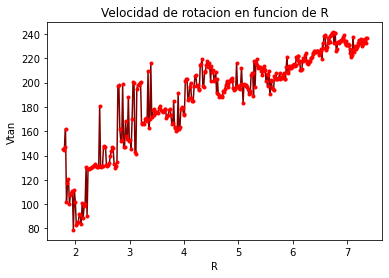

In [120]:
#curva de rotacion
plt.plot(R,vR, 'maroon')
plt.plot(R,vR, 'r.')
plt.grid
plt.title("Velocidad de rotacion en funcion de R")
plt.xlabel("R")
plt.ylabel("Vtan")